In [2]:
import sys
print(sys.prefix)

/usr


In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

In [2]:
full_train_df = pd.read_csv('train2023.csv', low_memory=False)
full_train_df.columns.values[1] = "Id"
full_test_df = pd.read_csv('test_ids.csv')
solutions_df = pd.read_csv('solution_ids.csv')

In [4]:
print(full_train_df.head())

   Unnamed: 0.1  Id                                     Path     Sex  Age  \
0             0   0  train/pid50512/study1/view1_frontal.jpg  Female   68   
1             1   1  train/pid21580/study2/view1_frontal.jpg  Female   87   
2             2   2  train/pid21580/study1/view1_frontal.jpg  Female   83   
3             3   3  train/pid21580/study1/view2_lateral.jpg  Female   83   
4             4   4  train/pid33839/study1/view1_frontal.jpg    Male   41   

  Frontal/Lateral AP/PA  No Finding  Enlarged Cardiomediastinum  Cardiomegaly  \
0         Frontal    AP         1.0                         NaN           NaN   
1         Frontal    AP        -1.0                         NaN           0.0   
2         Frontal    AP        -1.0                         NaN           NaN   
3         Lateral   NaN        -1.0                         NaN           NaN   
4         Frontal    AP        -1.0                         NaN           NaN   

   Lung Opacity  Pneumonia  Pleural Effusion  Pleu

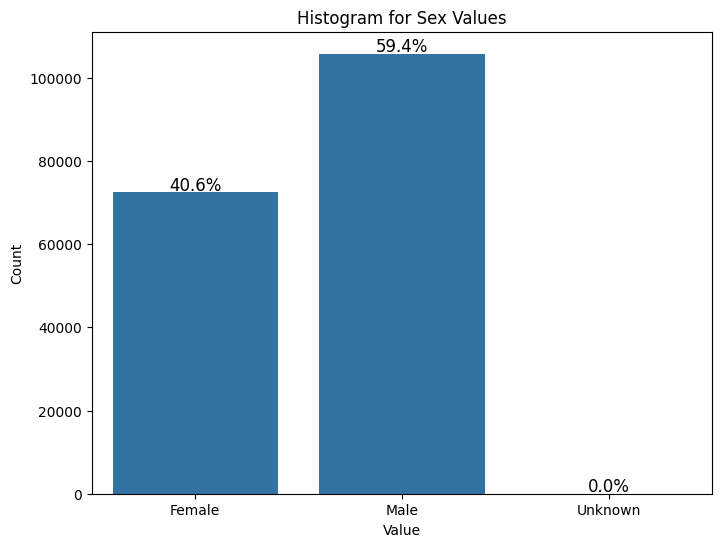

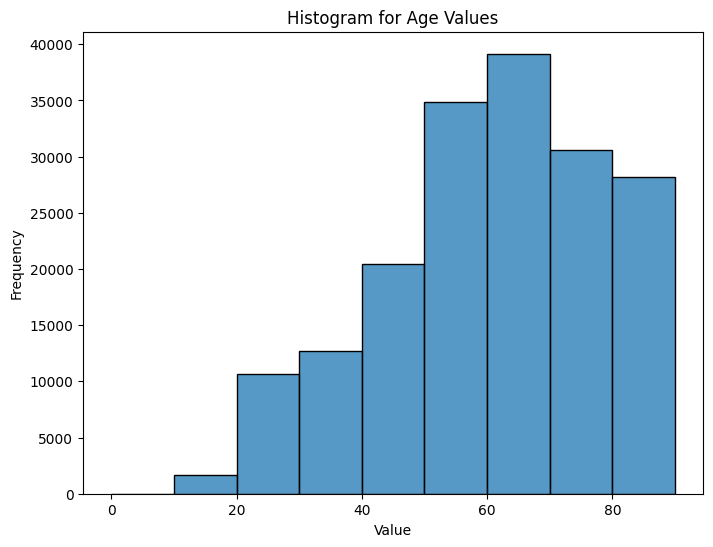

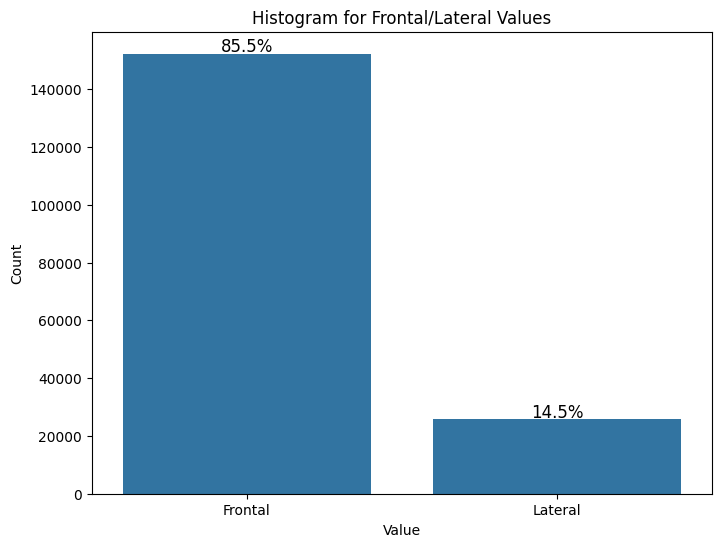

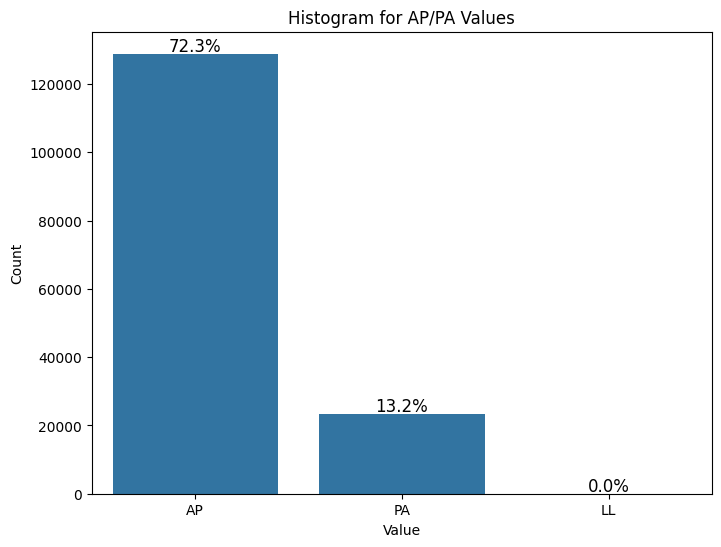

In [5]:
for column in full_train_df.columns[3: 7]:
    plt.figure(figsize=(8, 6))
    
    if full_train_df[column].dtype in ['float64', 'int64']:  # For numerical columns
        sns.histplot(full_train_df[column], bins = 9, kde=False)
        plt.title(f"Histogram for {column} Values")
        plt.xlabel("Value")
        plt.ylabel('Frequency')
    else:  # For categorical columns
        ax = sns.countplot(x=full_train_df[column])
        plt.title(f"Histogram for {column} Values")
        plt.xlabel("Value")
        plt.ylabel('Count')

        # Calculate the total number of entries in the column
        total_count = len(full_train_df[column])

        # Adding percentage labels on top of each bar
        for p in ax.patches:
            # Calculate the percentage for each bar
            percentage = 100 * p.get_height() / total_count
            ax.annotate(f'{percentage:.1f}%', 
                        (p.get_x() + p.get_width() / 2., p.get_height()), 
                        ha='center', va='center', 
                        fontsize=12, color='black', 
                        xytext=(0, 5), textcoords='offset points')
    plt.show()

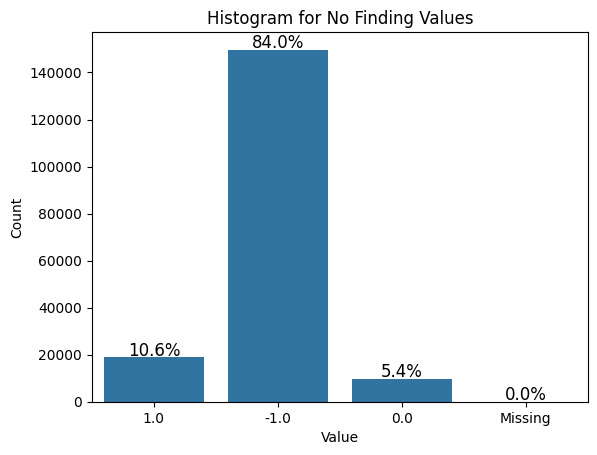

KeyboardInterrupt: 

In [5]:
import matplotlib.pyplot as plt
import seaborn as sns

for column in full_train_df.columns[7:16]:
    # Fill NaN values with a placeholder string
    data = full_train_df[column].fillna('Missing')

    ax = sns.countplot(x=data)
    plt.title(f"Histogram for {column} Values")
    plt.xlabel("Value")
    plt.ylabel("Count")

    # Calculate the total number of entries (including missing)
    total_count = len(data)

    # Adding percentage labels on top of each bar
    for p in ax.patches:
        percentage = 100 * p.get_height() / total_count
        ax.annotate(f'{percentage:.1f}%',
                    (p.get_x() + p.get_width() / 2., p.get_height()),
                    ha='center', va='center',
                    fontsize=12, color='black',
                    xytext=(0, 5), textcoords='offset points')
    
    plt.show()

In [3]:
import torch
import torch.nn as nn
from torchvision import models
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from torchvision.transforms.functional import to_pil_image
from PIL import Image
import os

In [11]:
class CSVDataset(Dataset):
    def __init__(self, dataframe, image_root_dir, target_columns=None, transform=None,
                 save_dir=None, use_saved_images=False):
        self.data = dataframe
        self.image_root_dir = image_root_dir
        self.target_columns = target_columns
        self.transform = transform
        self.save_dir = save_dir
        self.use_saved_images = use_saved_images

        if self.save_dir:
            os.makedirs(self.save_dir, exist_ok=True)

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        row = self.data.iloc[idx]
        original_image_path = os.path.join(self.image_root_dir, row['Path'])
        
        # Create saved image path with .pt extension using the index instead of image_filename
        saved_image_path = os.path.join(self.save_dir, f"{row['Id']}.pt")
        #print(saved_image_path)
        
        # Load and transform image
        if self.use_saved_images and saved_image_path and os.path.exists(saved_image_path):
            # Load the saved tensor directly if already saved
            image_tensor = torch.load(saved_image_path)
        else:
            image = Image.open(original_image_path).convert("RGB")  # Force RGB mode
            image_tensor = self.transform(image) if self.transform else transforms.ToTensor()(image)

            # Save transformed image tensor as a .pt file if applicable
            if self.save_dir and not self.use_saved_images:
                # Save tensor directly as a .pt file
                torch.save(image_tensor, saved_image_path)

        # Handle multi-label targets with NaN -> 0
        if self.target_columns:
            # Ensure the target columns are numeric before fillna
            labels = pd.to_numeric(row[self.target_columns], errors='coerce').fillna(0)
            labels = labels.astype(float).values
            labels = torch.tensor(labels, dtype=torch.float32)
            return image_tensor, labels
        
        return image_tensor

In [12]:
"""
print(len(full_train_df))
sixth = len(full_train_df) // 6
print(sixth)
df_arr = []

print(len(full_test_df))
twelfth = len(full_test_df) // 6
print(twelfth)
df_arr_test = []
"""

print(len(solutions_df))
sol_sixth = len(solutions_df) // 6
print(sol_sixth)

df_sol_arr = []
start = 0
for i in range(6):
    df_sol_arr.append(solutions_df.iloc[start:start + sol_sixth, :])
    start += sol_sixth
print(df_sol_arr[5][0:-1])

"""
start = 0
for i in range(6):
    df_arr.append(full_train_df.iloc[start:start + sixth, :])
    start += sixth
print(df_arr[5][0:-1])

start = 0
for i in range(12):
    df_arr_test.append(full_test_df.iloc[start:start + twelfth, :])
    start += twelfth
#print(df_arr_test[5])
"""


22660
3776
           Id                                         Path
18880  185293  solution/pid61334/study10/view1_frontal.jpg
18881  185294   solution/pid61334/study5/view1_frontal.jpg
18882  185295   solution/pid61334/study1/view1_frontal.jpg
18883  185296   solution/pid61334/study1/view2_frontal.jpg
18884  185297  solution/pid61334/study11/view1_frontal.jpg
...       ...                                          ...
22650  223307   solution/pid60000/study1/view1_frontal.jpg
22651  223320   solution/pid64004/study1/view1_frontal.jpg
22652  223340   solution/pid61174/study1/view1_frontal.jpg
22653  223342   solution/pid64110/study1/view1_frontal.jpg
22654  223357   solution/pid64075/study1/view1_frontal.jpg

[3775 rows x 2 columns]


'\nstart = 0\nfor i in range(6):\n    df_arr.append(full_train_df.iloc[start:start + sixth, :])\n    start += sixth\nprint(df_arr[5][0:-1])\n\nstart = 0\nfor i in range(12):\n    df_arr_test.append(full_test_df.iloc[start:start + twelfth, :])\n    start += twelfth\n#print(df_arr_test[5])\n'

In [13]:
image_root = '/central/groups/CS156b/data'
train_save_dir = './input_images/train'
test_save_dir = './input_images/test'
sol_save_dir = './input_images/solution'

image_transforms = transforms.Compose([
    transforms.Resize((224, 224)),  # Resize to standard ImageNet input size
    transforms.ToTensor(),          # Convert to tensor and scale to [0, 1]
    transforms.Normalize(           # Normalize with ImageNet stats
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225]
    )
])

In [16]:
# Create dataset
sol_dataset = CSVDataset(
    dataframe=solutions_df, 
    image_root_dir=image_root, 
    target_columns=None, 
    transform=image_transforms,  # Pass the transform
    save_dir=sol_save_dir, 
    use_saved_images=False  # Set to True if you want to load tensors from CSV
)

# Create DataLoader
sol_loader = DataLoader(sol_dataset, batch_size=32, shuffle=True)

# Iterate through batches
for batch_idx, (images) in enumerate(sol_loader):
    print(f"Batch {batch_idx + 1}")
    print("Images shape:", images.shape)

Batch 1
Images shape: torch.Size([32, 3, 224, 224])
Batch 2
Images shape: torch.Size([32, 3, 224, 224])
Batch 3
Images shape: torch.Size([32, 3, 224, 224])
Batch 4
Images shape: torch.Size([32, 3, 224, 224])
Batch 5
Images shape: torch.Size([32, 3, 224, 224])
Batch 6
Images shape: torch.Size([32, 3, 224, 224])
Batch 7
Images shape: torch.Size([32, 3, 224, 224])
Batch 8
Images shape: torch.Size([32, 3, 224, 224])
Batch 9
Images shape: torch.Size([32, 3, 224, 224])
Batch 10
Images shape: torch.Size([32, 3, 224, 224])
Batch 11
Images shape: torch.Size([32, 3, 224, 224])
Batch 12
Images shape: torch.Size([32, 3, 224, 224])
Batch 13
Images shape: torch.Size([32, 3, 224, 224])
Batch 14
Images shape: torch.Size([32, 3, 224, 224])
Batch 15
Images shape: torch.Size([32, 3, 224, 224])
Batch 16
Images shape: torch.Size([32, 3, 224, 224])
Batch 17
Images shape: torch.Size([32, 3, 224, 224])
Batch 18
Images shape: torch.Size([32, 3, 224, 224])
Batch 19
Images shape: torch.Size([32, 3, 224, 224])
Ba

In [ ]:
# Create dataset
train_dataset = CSVDataset(
    dataframe=df_arr[5][0:-1], 
    image_root_dir=image_root, 
    target_columns=["No Finding", "Enlarged Cardiomediastinum", "Cardiomegaly", "Lung Opacity",
    "Pneumonia", "Pleural Effusion", "Pleural Other", "Fracture", "Support Devices"], 
    transform=image_transforms,  # Pass the transform
    save_dir=train_save_dir, 
    use_saved_images=False  # Set to True if you want to load tensors from CSV
)

# Create DataLoader
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)

# Iterate through batches
for batch_idx, (images, labels) in enumerate(train_loader):
    print(f"Batch {batch_idx + 1}")
    print("Images shape:", images.shape)
    print("Labels shape:", labels.shape)
    # Do your training here

./input_images/train/213978.pt
./input_images/train/186419.pt
./input_images/train/213306.pt
./input_images/train/192203.pt
./input_images/train/189034.pt
./input_images/train/223188.pt
./input_images/train/214016.pt
./input_images/train/223319.pt
./input_images/train/201543.pt
./input_images/train/189101.pt
./input_images/train/207006.pt
./input_images/train/198679.pt
./input_images/train/188066.pt
./input_images/train/193436.pt
./input_images/train/203414.pt
./input_images/train/219413.pt
./input_images/train/186991.pt
./input_images/train/186772.pt
./input_images/train/190237.pt
./input_images/train/191649.pt
./input_images/train/212370.pt
./input_images/train/213681.pt
./input_images/train/190102.pt
./input_images/train/192668.pt
./input_images/train/190416.pt
./input_images/train/190869.pt
./input_images/train/190114.pt
./input_images/train/201399.pt
./input_images/train/203712.pt
./input_images/train/222617.pt
./input_images/train/209894.pt
./input_images/train/213412.pt
Batch 1


In [12]:
# Create dataset
test_dataset = CSVDataset(
    dataframe=full_test_df, 
    image_root_dir=image_root, 
    target_columns=None, 
    transform=image_transforms,  # Pass the transform
    save_dir=test_save_dir, 
    use_saved_images=False  # Set to True if you want to load tensors from CSV
)

# Create DataLoader
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=True)

# Iterate through batches
for batch_idx, (images) in enumerate(test_loader):
    print(f"Batch {batch_idx + 1}")
    print("Images shape:", images.shape)

./input_images/test/36553.pt
./input_images/test/104043.pt
./input_images/test/118581.pt
./input_images/test/152598.pt
./input_images/test/156961.pt
./input_images/test/216972.pt
./input_images/test/71422.pt
./input_images/test/26795.pt
./input_images/test/9598.pt
./input_images/test/176499.pt
./input_images/test/163816.pt
./input_images/test/27429.pt
./input_images/test/175888.pt
./input_images/test/209066.pt
./input_images/test/148598.pt
./input_images/test/201768.pt
./input_images/test/141060.pt
./input_images/test/163069.pt
./input_images/test/110787.pt
./input_images/test/29928.pt
./input_images/test/185714.pt
./input_images/test/75302.pt
./input_images/test/91580.pt
./input_images/test/134049.pt
./input_images/test/118556.pt
./input_images/test/175424.pt
./input_images/test/94895.pt
./input_images/test/152808.pt
./input_images/test/156289.pt
./input_images/test/126417.pt
./input_images/test/122550.pt
./input_images/test/188970.pt
Batch 1
Images shape: torch.Size([32, 3, 224, 224]

In [10]:
class MultiLabelResNet50(nn.Module):
    def __init__(self, num_classes):
        super(MultiLabelResNet50, self).__init__()
        self.base_model = models.resnet50(weights=models.ResNet50_Weights.IMAGENET1K_V1)
        self.base_model.fc = nn.Sequential(
            nn.Linear(self.base_model.fc.in_features, num_classes),
            nn.Sigmoid()
        )

    def forward(self, x):
        return self.base_model(x)

In [ ]:
import torchvision.transforms as T
from torchvision.transforms import functional as F

In [ ]:
import os
import torch
import torchvision.transforms as transforms

# Paths
saved_tensor_dir = './input_images/train'  # or test
flipped_tensor_dir = './input_images/train_flipped'

# Create the output directory if it doesn't exist
os.makedirs(flipped_tensor_dir, exist_ok=True)

# Horizontal flip transform
flip_transform = transforms.Compose([
    transforms.RandomHorizontalFlip(p=1.0),  # Always flip
])

# Loop through all .pt files in the directory
for filename in os.listdir(saved_tensor_dir):
    if filename.endswith('.pt'):
        flipped_path = os.path.join(flipped_tensor_dir, filename)
        
        # Skip if flipped image already exists
        if filename in os.listdir(flipped_tensor_dir):
            #print(f"Skipped (already exists): {filename}")
            continue
        
        tensor_path = os.path.join(saved_tensor_dir, filename)

        # Load the saved image tensor
        image_tensor = torch.load(tensor_path)

        # Ensure it's a 3D tensor (C, H, W)
        if image_tensor.ndim == 3:
            flipped_tensor = flip_transform(image_tensor)
        else:
            #print(f"Skipping non-image tensor: {filename}")
            continue

        # Save the flipped tensor
        torch.save(flipped_tensor, flipped_path)
        print(f"Saved flipped: {flipped_path}")

Saved flipped: ./input_images/train_flipped/130436.pt
Saved flipped: ./input_images/train_flipped/88044.pt
Saved flipped: ./input_images/train_flipped/210995.pt
Saved flipped: ./input_images/train_flipped/115680.pt
Saved flipped: ./input_images/train_flipped/92843.pt
Saved flipped: ./input_images/train_flipped/218401.pt
Saved flipped: ./input_images/train_flipped/79080.pt
Saved flipped: ./input_images/train_flipped/117310.pt
Saved flipped: ./input_images/train_flipped/114413.pt
Saved flipped: ./input_images/train_flipped/124541.pt
Saved flipped: ./input_images/train_flipped/111162.pt
Saved flipped: ./input_images/train_flipped/141022.pt
Saved flipped: ./input_images/train_flipped/110938.pt
Saved flipped: ./input_images/train_flipped/220585.pt
Saved flipped: ./input_images/train_flipped/40594.pt
Saved flipped: ./input_images/train_flipped/220833.pt
Saved flipped: ./input_images/train_flipped/143298.pt
Saved flipped: ./input_images/train_flipped/52670.pt
Saved flipped: ./input_images/tra

In [3]:
import torch
import matplotlib.pyplot as plt
import torchvision.transforms as transforms
from torchvision.transforms.functional import to_pil_image

def show_tensor_image(tensor_path, normalize=False, save_path=None):
    # Load the saved tensor
    image_tensor = torch.load(tensor_path)

    # Remove batch dimension if present
    if image_tensor.ndim == 4:
        image_tensor = image_tensor[0]

    # Denormalize if required
    if normalize:
        mean = torch.tensor([0.485, 0.456, 0.406]).view(3,1,1)
        std = torch.tensor([0.229, 0.224, 0.225]).view(3,1,1)
        image_tensor = image_tensor * std + mean

    # Clip and prepare for display
    image_np = image_tensor.permute(1, 2, 0).numpy().clip(0, 1)
    
    # Display with matplotlib
    plt.imshow(image_np, cmap='gray' if image_np.shape[2] == 1 else None)
    plt.axis('off')
    plt.show()

    # Optionally save to disk
    if save_path:
        # Convert to PIL Image and save
        image_pil = to_pil_image(image_tensor.clip(0, 1))
        image_pil.save(save_path)
        print(f"Image saved to: {save_path}")

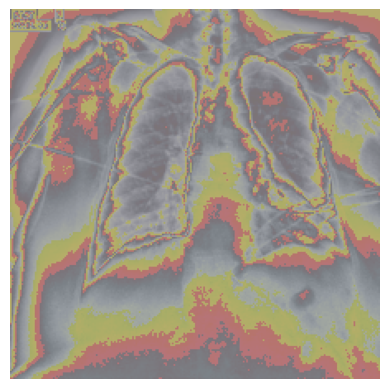

Image saved to: image_0_contrast.png


In [4]:
show_tensor_image('./input_images/train_contrast/0.pt', normalize=True, save_path='image_0_contrast.png')

In [11]:
# Paths
input_dir = './input_images/train'
output_dir = './input_images/train_contrast'
os.makedirs(output_dir, exist_ok=True)

# Helper: Convert tensor to PIL and back
def tensor_to_pil(tensor):
    return F.to_pil_image(tensor.cpu())

def pil_to_tensor(image):
    return F.to_tensor(image)

# Define contrast levels
contrast_factors = [1.5]  # 1.0 = original, <1 = lower contrast, >1 = higher

# Loop over all image tensors
for fname in os.listdir(input_dir):
    if fname.endswith('.pt'):
        base_name = fname.replace('.pt', '')
        skip = False

        for factor in contrast_factors:
            suffix = f'_contrast_{factor:.1f}'.replace('.', '_')
            output_path = os.path.join(output_dir, f"{base_name}{suffix}.pt")
            if os.path.exists(output_path):
                print(f"Skipping {fname}, already processed for contrast factor {factor}")
                skip = True
                break  # If one version exists, skip this file

        if skip:
            continue

        tensor_path = os.path.join(input_dir, fname)
        image_tensor = torch.load(tensor_path)

        # Ensure tensor is shape (C, H, W)
        if image_tensor.ndim != 3:
            print(f"Skipping {fname}, invalid shape: {image_tensor.shape}")
            continue

        # Convert to PIL for contrast adjustment
        image_pil = tensor_to_pil(image_tensor)

        for factor in contrast_factors:
            contrast_transform = T.functional.adjust_contrast(image_pil, factor)
            contrast_tensor = pil_to_tensor(contrast_transform)

            # Save augmented tensor
            suffix = f'_contrast_{factor:.1f}'.replace('.', '_')
            output_path = os.path.join(output_dir, f"{base_name}{suffix}.pt")
            torch.save(contrast_tensor, output_path)
            print(f"Saved: {output_path}")

Skipping 87926.pt, already processed for contrast factor 1.5
Skipping 31894.pt, already processed for contrast factor 1.5
Skipping 215270.pt, already processed for contrast factor 1.5
Skipping 134879.pt, already processed for contrast factor 1.5
Skipping 202116.pt, already processed for contrast factor 1.5
Skipping 25984.pt, already processed for contrast factor 1.5
Skipping 57379.pt, already processed for contrast factor 1.5
Skipping 44022.pt, already processed for contrast factor 1.5
Skipping 153280.pt, already processed for contrast factor 1.5
Skipping 85854.pt, already processed for contrast factor 1.5
Skipping 208937.pt, already processed for contrast factor 1.5
Skipping 200710.pt, already processed for contrast factor 1.5
Skipping 115316.pt, already processed for contrast factor 1.5
Skipping 97890.pt, already processed for contrast factor 1.5
Skipping 219694.pt, already processed for contrast factor 1.5
Skipping 67567.pt, already processed for contrast factor 1.5
Skipping 56737.p

In [7]:
import re

# Folder containing contrast-augmented files
folder_path = './input_images/train_contrast'

# Regex pattern to match filenames like 'i_contrast_1_5.pt'
pattern = re.compile(r'^(.*)_contrast_\d+_\d+\.pt$')

# Rename matching files
for filename in os.listdir(folder_path):
    match = pattern.match(filename)
    if match:
        base_name = match.group(1)
        new_filename = f"{base_name}.pt"

        old_path = os.path.join(folder_path, filename)
        new_path = os.path.join(folder_path, new_filename)

        # Optional: Skip rename if target name already exists
        if os.path.exists(new_path):
            print(f"Skipping (already exists): {new_path}")
            continue

        os.rename(old_path, new_path)
        print(f"Renamed: {filename} -> {new_filename}")

Renamed: 177166_contrast_1_5.pt -> 177166.pt
Renamed: 73689_contrast_1_5.pt -> 73689.pt
Renamed: 202812_contrast_1_5.pt -> 202812.pt
Renamed: 87436_contrast_1_5.pt -> 87436.pt
Renamed: 41076_contrast_1_5.pt -> 41076.pt
Renamed: 41199_contrast_1_5.pt -> 41199.pt
Renamed: 43060_contrast_1_5.pt -> 43060.pt
Renamed: 18680_contrast_1_5.pt -> 18680.pt
Renamed: 2872_contrast_1_5.pt -> 2872.pt
Renamed: 5311_contrast_1_5.pt -> 5311.pt
Renamed: 169202_contrast_1_5.pt -> 169202.pt
Renamed: 76728_contrast_1_5.pt -> 76728.pt
Renamed: 47285_contrast_1_5.pt -> 47285.pt
Renamed: 86755_contrast_1_5.pt -> 86755.pt
Renamed: 164398_contrast_1_5.pt -> 164398.pt
Renamed: 141006_contrast_1_5.pt -> 141006.pt
Renamed: 100754_contrast_1_5.pt -> 100754.pt
Renamed: 10922_contrast_1_5.pt -> 10922.pt
Renamed: 132734_contrast_1_5.pt -> 132734.pt
Renamed: 92261_contrast_1_5.pt -> 92261.pt
Renamed: 69226_contrast_1_5.pt -> 69226.pt
Renamed: 112061_contrast_1_5.pt -> 112061.pt
Renamed: 28751_contrast_1_5.pt -> 28751.pt